In [79]:
using WAV
recording_filename = "../signal_generator/experimenta_sin1000.wav"
gt_filename = "../signal_generator/1000Hz.wav"
rec_sig, sample_rate = wavread(recording_filename)
gt_sig, sample_rate2 = wavread(gt_filename)

([0.012482070375682853; 0.19177831354716635; … ; -0.3847468489638966; -0.19190038758507036;;], 32000.0f0, 0x0010, WAVChunk[WAVChunk(Symbol("fmt "), UInt8[0x10, 0x00, 0x00, 0x00, 0x01, 0x00, 0x01, 0x00, 0x00, 0x7d, 0x00, 0x00, 0x00, 0xfa, 0x00, 0x00, 0x02, 0x00, 0x10, 0x00])])

In [80]:
sample_rate2

32000.0f0

In [81]:
size(rec_sig)

(320000, 8)

In [82]:
using Statistics
sig = 1:1000
mean(sig)
std(sig)

288.8194360957494

In [86]:
function normalize_signal(signal)
    mean_sig = mean(sig);
    std_sig = std(sig);

    return (signal .- mean_sig) ./ std_sig;
end

normalize_signal (generic function with 1 method)

In [87]:
using DSP: xcorr
padding = zeros(size(rec_sig[:,1],1) - size(gt_sig[:,1],1))
padded = append!(rec_sig[:,1], padding)
corr_X = xcorr(normalize_signal(gt_sig[:,1]), normalize_signal(padded));


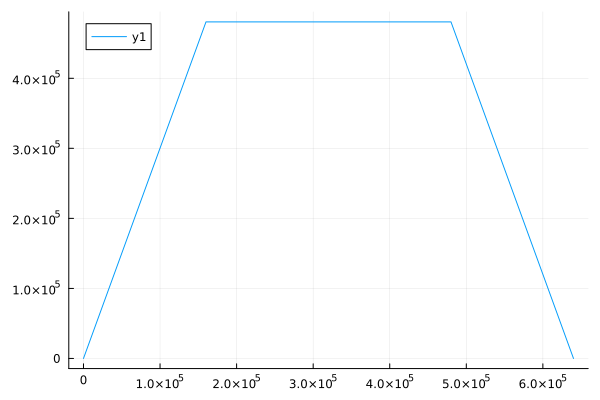

In [88]:
plot(corr_X)

In [89]:
mid_point = size(corr_X, 1) / 2

319999.5

In [90]:
max_val, max_idx = findmax(corr_X)

(480481.1928806245, 309226)

In [91]:
mid_point - max_idx

10773.5

In [29]:
using SignalAnalysis: mfilter
mfilter(gt_sig[:,1], rec_sig[:,1])

SampledSignal @ 1.0 Hz, 4676848-element Vector{Float64}:
  9.399957969082095
  8.984310420028322
  8.989082515726501
  9.210582552969086
  9.164264116481757
  9.351366222636228
  9.29623939939685
  9.186542803498565
  9.256312550458102
  9.289699551146535
  ⋮
 -0.00010494131347993374
 -8.070402681975564e-5
 -6.15185421332376e-5
 -4.235541054553593e-5
 -2.9453011419662556e-5
 -1.662139714642477e-5
 -8.805261043104418e-6
 -2.742912378728146e-6
  7.216449660063518e-15

In [92]:
using DSP: finddelay
partial_idx = 10000;
delay_idx = finddelay(normalize_signal(rec_sig[:,1]), normalize_signal(gt_sig[1:end,1]))

159999

In [11]:
using Plots

In [93]:
size(rec_sig,1) > size(gt_sig, 1)

true

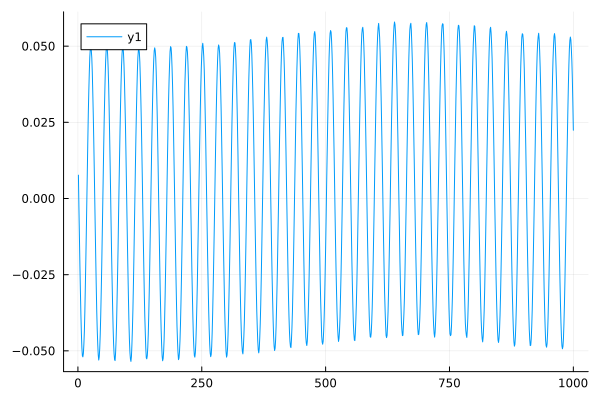

In [94]:
end_idx = size(gt_sig, 1) + delay_idx;
cropped_sig = rec_sig[delay_idx:end, 1];
plot(cropped_sig[1:1000])


In [95]:
using WAV: wavwrite
wavwrite(cropped_sig, sample_rate, "test2.wav")

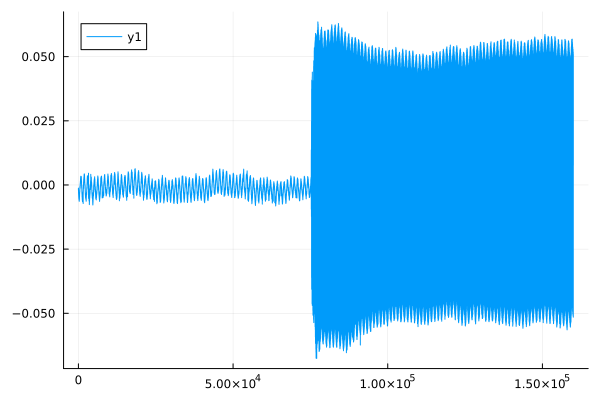

In [96]:
plot(rec_sig[1:delay_idx, 1])

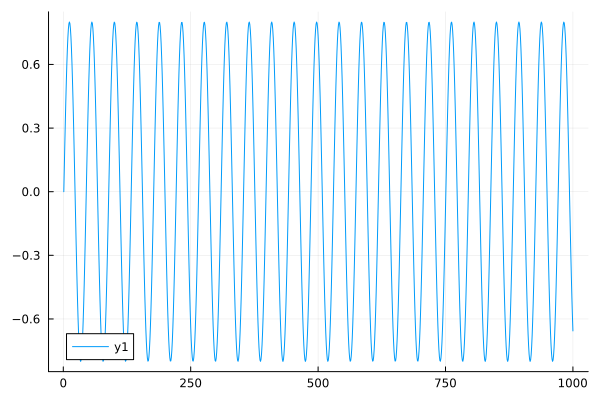

In [60]:
plot(gt_sig[1:1000,1])

In [ ]:
gt